<a href="https://colab.research.google.com/github/joeybose/GGM_LOG_Tutorial/blob/master/LoG_GGM_Torus_flow_matching_example.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Geometric Generative Modeling Tutorial - Part III

In this notebook we will implement a minimal example of a Flow Matching generative model on the Torus manifold.

We will follow the recipe from the slides for building a Flow Matching model:


1.   Data: source distribution $p$ and target distribution $q$
2.   Construct: probability path $p_t$ s.t. $p_0=p$ and $p_1\approx q$ via conditional flows.
3. Learn: neural network parameterizing the velocity field $u^\theta_t$ with CFM loss.

After training our model we will generate samples using a simple Euler method ODE numerical solver.




In [ ]:
# !git clone https://github.com/joeybose/GGM_LOG_Tutorial
# %cd GGM_LOG_Tutorial

Cloning into 'GGM_LOG_Tutorial'...
remote: Enumerating objects: 28, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (27/27), done.
remote: Total 28 (delta 8), reused 5 (delta 1), pack-reused 0 (from 0)
Receiving objects: 100% (28/28), 14.03 MiB | 7.52 MiB/s, done.
Resolving deltas: 100% (8/8), done.
/content/GGM_LOG_Tutorial


## Setup for Neural Network Training

### Architecture

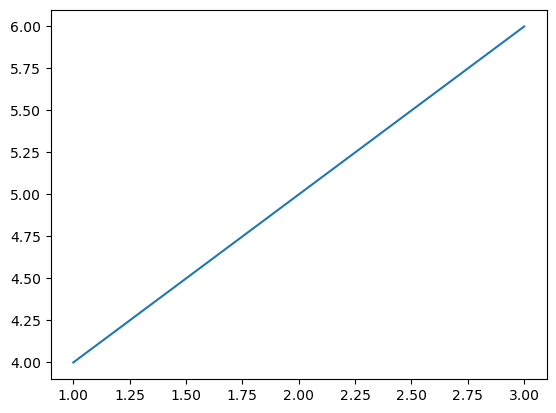

In [1]:
import matplotlib.pyplot as plt

plt.plot([1,2,3], [4,5,6])
plt.show()

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader


class Swish(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x):
        return torch.sigmoid(x)*x


class MLP(nn.Module):
  def __init__(self, input_size, hidden_size, output_size, num_layers):
    super(MLP, self).__init__()

    self.num_layers = num_layers
    self.layers = nn.ModuleList()

    self.layers.append(nn.Linear(input_size, hidden_size))
    for i in range(self.num_layers-2):
        self.layers.append(nn.Linear(hidden_size, hidden_size))
    self.layers.append(nn.Linear(hidden_size, output_size))

    self.act = Swish()

  def forward(self, x, t):
    x = torch.cat([t, x],dim=1)
    for i in range(self.num_layers-1):
      x = self.act(self.layers[i](x))
    out = self.layers[-1](x)
    return out


### Model and Optimizer

In [3]:

use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")
model = MLP(input_size=3,hidden_size=512,output_size=2,num_layers=5).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


## Dataset

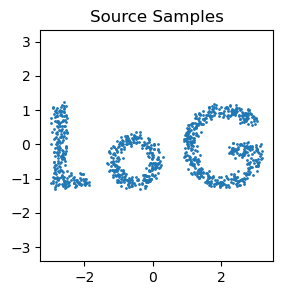

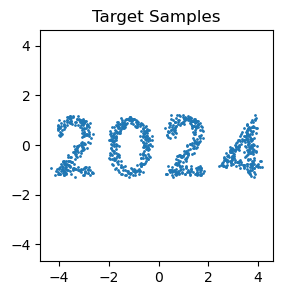

In [4]:
import numpy as np
import torch
from PIL import Image, ImageDraw, ImageFont
from matplotlib import pyplot as plt


def sample_points_from_mask(mask, num_samples=1000, sigma=0.05):
    # Get the indices of the pixels that are part of the letters
    letter_indices = np.argwhere(mask)

    # Uniformly sample points from these indices
    sampled_indices = letter_indices[np.random.choice(len(letter_indices), num_samples)]
    x = sampled_indices.astype(np.float32)
    x[:, 0] = -(x[:, 0] - mask.shape[0]//2) / (mask.shape[0]//8 )
    x[:, 1] = (x[:, 1] - mask.shape[1]//2) / (mask.shape[0]//8)
    x = np.flip(x,1)
    x = torch.tensor(x.astype('float32'))
    x = x + sigma * torch.randn_like(x)
    return x


# Load the mask
source_mask = Image.open(r'assets/log_conf.png')
source_mask = np.array(source_mask)
source_mask = (source_mask>0)[:,:,0]

# Load the mask
target_mask = Image.open(r'assets/2024.png')
target_mask = np.array(target_mask)
target_mask = (target_mask>0)[:,:,0]


source_samples = sample_points_from_mask(source_mask, num_samples=1000).numpy()
target_samples = sample_points_from_mask(target_mask, num_samples=1000).numpy()

def plot_x(xt_, title=''):
    plt.figure(figsize=(3,3))
    plt.scatter(xt_[:,0],xt_[:,1],s=1)
    plt.axis('equal')
    plt.title(title)
    plt.show()

plot_x(source_samples, title='Source Samples')
plot_x(target_samples, title='Target Samples')


## Conditional Flows

In [5]:
def CondOT_flow(x0, x1, t):
  xt = (1-t)*x0 + t*x1
  return xt

def CondOT_ut(x0, x1, t):
  cond_ut = x1-x0
  return cond_ut

## Training Loop

In [6]:
n_iters = 1000
batch_size = 5000

for iter in range(n_iters):

    optimizer.zero_grad()

    # sample t~U[0,1]
    t = torch.rand((batch_size,1)).to(device)

    # sample x0~p
    x0 = sample_points_from_mask(source_mask, num_samples=batch_size).to(device)

    # sample x1~q
    x1 = sample_points_from_mask(target_mask, num_samples=batch_size).to(device)

    # compute conditional affine flow
    # xt = psi_t(x0|x1) = sigma_t*x0 + alpha_t*x1
    xt = CondOT_flow(x0, x1, t)

    # compute conditional velocity
    # u_t(x|x1) = dsigma_t/dt*x0 + dalpha_t/dt*x1
    ut = CondOT_ut(x0, x1, t)

    # forward
    vt = model(xt,t)

    # loss
    loss = (vt - ut).pow(2).mean()

    # optimize
    loss.backward()
    optimizer.step()

    if iter % 1000 == 0:
        print(f'finished {iter} iterations')



finished 0 iterations


## Generate Samples

### ODE Solver - Euler

We implement [Euler Method](https://en.wikipedia.org/wiki/Euler_method) for numerically solving ODEs.

In [7]:
def Euler(ut, x_init, t_start=0., t_end=1., num_steps=100):
    xt = x_init
    t = t_start*torch.ones((xt.shape[0],1)).to(device)
    dt = (t_end-t_start)/num_steps

    with torch.no_grad():
      for i in range(num_steps):
        xt = xt + ut(xt,t) * dt
        t  = t + dt

    return xt

### Sample

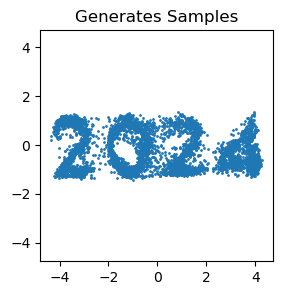

In [8]:
# sample from source distribution
x0 = sample_points_from_mask(source_mask, num_samples=5000).to(device)
t = torch.zeros((5000,1)).to(device)

# use Euler ODE solver to generate samples
xt = Euler(model, x0, t_start=0, t_end=1, num_steps=100)

plot_x(xt.detach().cpu().numpy(), title='Generates Samples')



## Sample and animate

In [9]:
x0 = sample_points_from_mask(source_mask, num_samples=5000).to(device)
t = torch.zeros((5000,1)).to(device)
xt = x0

N = 100
traj = []
with torch.no_grad():
    for i in range(N):

        vt = model(xt,t)
        xt = xt + vt/N
        t = t + 1/N

        if (i+1) % 2 ==0:
            xt_ = xt.cpu().numpy()
            traj.append(xt_)


import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150
plt.ioff()

fig, ax = plt.subplots()
def animate(i):
    ax.cla()
    ax.scatter(traj[i][:,0],traj[i][:,1],s=1)
    ax.set_xlim(-4,4)
    ax.set_ylim(-1,1.5)
    ax.axis('off')
    ax.axis('equal')
    return fig
ani = animation.FuncAnimation(fig, animate, frames=50)
display(ani)

# Torus Flow Matching

Now we transform this to distributions on the torus. We change the coordinate system to $\theta, \phi \in [-\pi, \pi]^2$.

First we define some useful plotting functions for the torus

In [ ]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio


# Generate torus surface
def create_torus_surface(R=3, r=1, resolution=200): # Create resolution * resolution grid
    u = np.linspace(0, 2 * np.pi, resolution)
    v = np.linspace(0, 2 * np.pi, resolution)
    u, v = np.meshgrid(u, v)

    x = (R + r * np.cos(v)) * np.cos(u)
    y = (R + r * np.cos(v)) * np.sin(u)
    z = r * np.sin(v)
    return x, y, z

# Generate scatter points on torus
def angles_to_torus_points(phi, theta, R=3, r=1):
    x = (R + r * np.cos(phi)) * np.cos(theta)
    y = (R + r * np.cos(phi)) * np.sin(theta)
    z = r * np.sin(phi)
    return x, y, z



def vis_points_on_torus(samples, title=''):
  ''' Visualize points on a torus using Plotly.
  
    Args:
    samples: A tensor of shape (N, 2) where N is the number of points.
             The first column contains angles phi and the second column contains angles theta.
  
    Returns:
    3D plot of the torus surface with points scattered.
   
   '''

  # Torus parameters
  R = 3  # Major radius
  r = 1  # Minor radius

  # Generate scatter points on the torus surface.
  x_surface, y_surface, z_surface = create_torus_surface(R, r)

  # x_points, y_points, z_points = generate_torus_points(source_samples[:,1].numpy(), source_samples[:,0].numpy(), R, r)
  x_points, y_points, z_points = angles_to_torus_points(samples[...,1], samples[...,0],  R, r)
  # x_points, y_points, z_points share same shape as samples[..., 1], samples[..., 0]


  # Create the torus surface plot
  color1 = 'grey'
  torus_surface = go.Surface(
      x=x_surface, y=y_surface, z=z_surface,
      colorscale=[[0, color1], [1,color1]], opacity=0.5
  )

  
  def scatter(x,y,z, color, size):
    # Create the scatter plot surface
    scatter_points = go.Scatter3d(
        x=x, y=y, z=z,
        mode='markers',
        marker=dict(
            size=size,
            color=np.sqrt(x**2 + y**2 + z**2),
            colorscale=[[0, color], [1,color]],
            opacity=0.9,
        ),
    )
    return scatter_points


  b = scatter(x_points[1:-1].flatten(), y_points[1:-1].flatten(), z_points[1:-1].flatten(), "olive", 1) 
  a = scatter(x_points[0], y_points[0], z_points[0], "blue", 4)
  c = scatter(x_points[-1], y_points[-1], z_points[-1], "black", 4)

  # Set up the layout
  layout = go.Layout(
      title=title,
      scene=dict(
          xaxis=dict(title='X'),
          yaxis=dict(title='Y'),
          zaxis=dict(title='Z'),
          aspectmode='data'
      )
  )

  # Create the figure and display it
  fig = go.Figure(data=[torus_surface,a,b,c], layout=layout)
  pio.show(fig)


<span style="color: yellow"> What is ```b```'s purpose in the above cell? </span>

Next we move the original samples to nice locations on the torus and visualize them both on the intrinsic (2d) coordinates and the extrinsic (3d) coordinates.

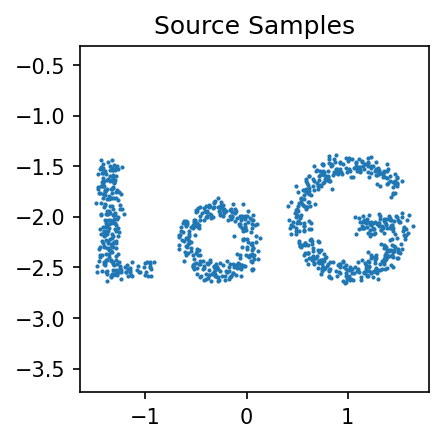

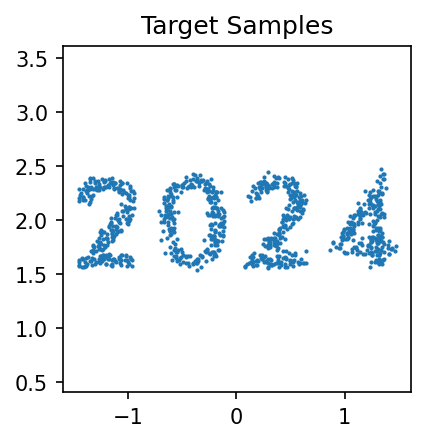

In [24]:
import math

def sample_source(num_samples):
  source_samples = sample_points_from_mask(source_mask, num_samples=num_samples)
  source_samples *= 0.5
  source_samples += torch.tensor([0, -2])
  return source_samples

def sample_target(num_samples):

  target_samples = sample_points_from_mask(target_mask, num_samples=num_samples)
  target_samples *= 0.5
  target_samples = target_samples * 0.7 + torch.tensor([0, 2])
  return target_samples
plt.close()
plot_x(sample_source(1000), title='Source Samples')
plot_x(sample_target(1000), title='Target Samples')


In [42]:
vis_points_on_torus(torch.stack([sample_source(1000), sample_target(1000)]), title='Ground truth distributions')
# The thing in argument has shape (2, 1000, 2), where the first dimension is the source and target samples, and the second dimension is the x and y coordinates of the points on the torus.

torch.Size([0, 1000]) torch.Size([2, 1000]) torch.Size([2, 1000])


C:\Users\Shucheng\AppData\Local\Temp\ipykernel_26200\24028947.py:19: DeprecationWarning:

__array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)

C:\Users\Shucheng\AppData\Local\Temp\ipykernel_26200\24028947.py:20: DeprecationWarning:

__array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)

C:\Users\Shucheng\AppData\Local\Temp\ipykernel_26200\24028947.py:21: DeprecationWarning:

__array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)

C:\Users\Shucheng\AppData\Local\Temp\ipykernel_26200\24028947.py:63: DeprecationWarning:

__array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)



In [43]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")
model = MLP(input_size=3,hidden_size=512,output_size=2,num_layers=5).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

def sym_mod(a, b=(2 * math.pi)):
  return (a + b / 2) % b - b / 2

def log_map(x0, x1):
  return sym_mod(x1 - x0)

def get_xt(x0, x1, t):
  log_x1 = log_map(x0, x1)
  return sym_mod(t * log_x1 + x0)

def get_ut(xt, x1, t):
  log_x0_xt = sym_mod(x1 - xt)
  return log_x0_xt / torch.clamp(1 - t, min=1e-4)

n_iters = 5000
batch_size = 5000

for iter in range(n_iters):

    optimizer.zero_grad()

    # sample t~U[0,1]
    t = torch.rand((batch_size,1)).to(device)

    # sample x0~p
    x0 = sample_source(batch_size).to(device)

    # sample x1~q
    x1 = sample_target(batch_size).to(device)

    # compute conditional affine flow
    # xt = psi_t(x0|x1) = sigma_t*x0 + alpha_t*x1
    xt = get_xt(x0, x1, t)

    # compute conditional velocity
    # u_t(x|x1) = dsigma_t/dt*x0 + dalpha_t/dt*x1
    ut = get_ut(xt, x1, t)

    # forward
    vt = model(xt,t)

    # loss
    loss = (vt - ut).pow(2).mean()

    # optimize
    loss.backward()
    optimizer.step()

    if iter % 1000 == 0:
        print(f'finished {iter} iterations')



finished 0 iterations
finished 1000 iterations
finished 2000 iterations
finished 3000 iterations
finished 4000 iterations


In [44]:
def wrapped_euler(ut, x_init, t_start=0., t_end=1., num_steps=100):
    xts = [x_init]
    t = t_start*torch.ones((x_init.shape[0],1)).to(device)
    dt = (t_end-t_start)/num_steps

    with torch.no_grad():
      for i in range(num_steps):
        xt = xts[-1]
        xts.append(sym_mod(xt + ut(xt,t) * dt))
        t  = t + dt
    xts = torch.stack(xts)
    return xts

In [45]:
def plot_trajectories(traj):
    """Plot trajectories of some selected samples."""
    n = 2000
    plt.figure(figsize=(6, 6))
    plt.scatter(traj[0, :n, 0], traj[0, :n, 1], s=10, alpha=0.8, c="black")
    plt.scatter(traj[:, :n, 0], traj[:, :n, 1], s=0.2, alpha=0.2, c="olive")
    plt.scatter(traj[-1, :n, 0], traj[-1, :n, 1], s=4, alpha=1, c="blue")
    plt.legend([r"Prior $p_0$", "Flow", r"Predicted $p_1$"])
    plt.xticks([])
    plt.yticks([])
    plt.xlim(-math.pi, math.pi)
    plt.ylim(-math.pi, math.pi)
    plt.show()

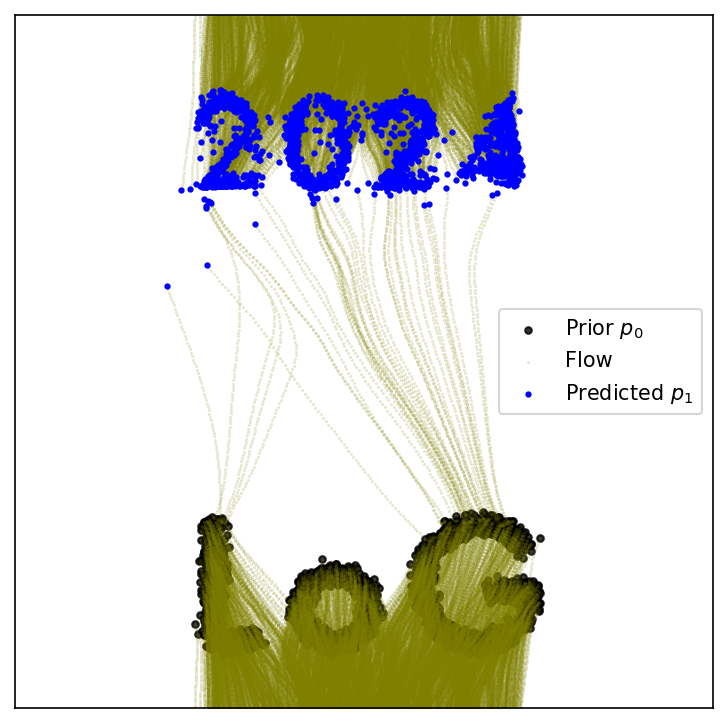

In [46]:
traj = wrapped_euler(model, x0, t_start=0, t_end=1, num_steps=100).cpu().numpy()
plot_trajectories(traj)

In [47]:
from IPython.display import HTML
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150
plt.ioff()

fig, ax = plt.subplots()
def animate(i):
    n = 10000
    ax.cla()
    ax.scatter(traj[0, :n, 0], traj[0, :n, 1], s=10, alpha=0.8, c="black")
    ax.scatter(traj[0:i, :n, 0], traj[0:i, :n, 1], s=0.2, alpha=0.2, c="olive")
    ax.scatter(traj[i, :n, 0], traj[i, :n, 1], s=10, alpha=0.8, c="black")
    ax.scatter(traj[-1, :n, 0], traj[-1, :n, 1], s=4, alpha=1, c="blue")
    ax.set_xlim(-math.pi, math.pi)
    ax.set_ylim(-math.pi, math.pi)
    #ax.axis('off')
    #ax.axis('equal')
    return fig
ani = animation.FuncAnimation(fig, animate, frames=100)
display(ani)

In [48]:
vis_points_on_torus(traj[:, :1000], title='Trajectories')

(99, 1000) (101, 1000) (101, 1000)
